In [47]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score


In [24]:
df = pd.read_csv('C:/Users/Shree/Desktop/dataset_tk.csv')

In [5]:
#Data Prprocessing

# first few rows of the dataset
print(df.head())

# missing values
print("Missing values per column:")
print(df.isnull().sum())

# data types of each column
print("Data types of columns:")
print(df.dtypes)

# duplicate rows
duplicates = df.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")

# Drop duplicates
df_cleaned = df.drop_duplicates()

               Date  Punjab  Haryana  Rajasthan  Delhi     UP  Uttarakhand  \
0  02-01-2019 00:00   119.9    130.3      234.1   85.8  313.9         40.7   
1  03-01-2019 00:00   121.9    133.5      240.2   85.5  311.8         39.3   
2  04-01-2019 00:00   118.8    128.2      239.8   83.5  320.7         38.1   
3  05-01-2019 00:00   121.0    127.5      239.1   79.2  299.0         39.2   
4  06-01-2019 00:00   121.4    132.6      240.4   76.6  286.8         39.2   

     HP   J&K  Chandigarh  ...  Odisha  West Bengal  Sikkim  \
0  30.0  52.5         5.0  ...    70.2        108.2     2.0   
1  30.1  54.1         4.9  ...    67.9        110.2     1.9   
2  30.1  53.2         4.8  ...    66.3        106.8     1.7   
3  30.2  51.5         4.3  ...    65.8        107.0     2.0   
4  31.0  53.2         4.3  ...    62.9        106.4     2.0   

   Arunachal Pradesh  Assam  Manipur  Meghalaya  Mizoram  Nagaland  Tripura  
0                2.1   21.7      2.7        6.1      1.9       2.2      3.

Correlation Matrix:
                     Punjab   Haryana  Rajasthan     Delhi        UP  \
Punjab             1.000000  0.955670   0.376721  0.902512  0.804649   
Haryana            0.955670  1.000000   0.517610  0.942060  0.839751   
Rajasthan          0.376721  0.517610   1.000000  0.442719  0.360466   
Delhi              0.902512  0.942060   0.442719  1.000000  0.906172   
UP                 0.804649  0.839751   0.360466  0.906172  1.000000   
Uttarakhand        0.656262  0.764229   0.749317  0.733879  0.646279   
HP                 0.437242  0.552601   0.738944  0.453851  0.313448   
J&K               -0.178045 -0.140497   0.382112 -0.162798 -0.128536   
Chandigarh         0.895890  0.926031   0.530860  0.935308  0.829112   
Chhattisgarh       0.367010  0.406083   0.225714  0.466436  0.481145   
Gujarat            0.170198  0.289899   0.619435  0.354093  0.330733   
MP                -0.355840 -0.237214   0.569785 -0.272191 -0.231171   
Maharashtra       -0.078480  0.007564   0.41

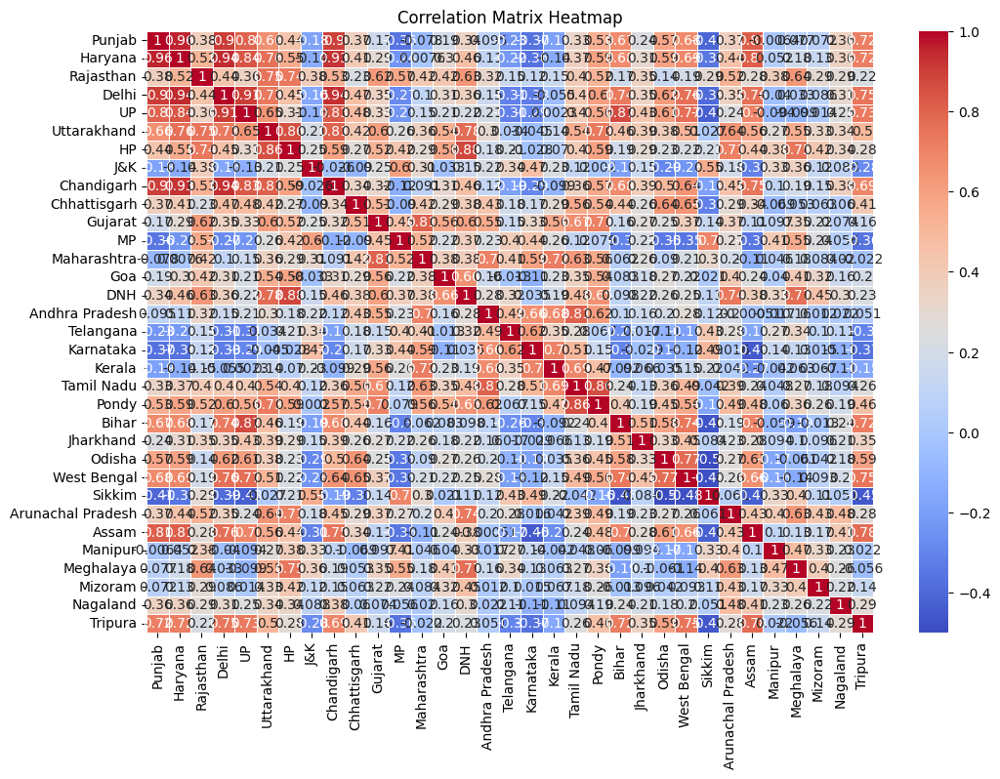

In [6]:
#correlation Analysis

# Drop the 'Date' column 
data_numeric = df.drop(columns=['Date'])

# Compute the Pearson correlation matrix
correlation_matrix = data_numeric.corr()

#correlation matrix
print("Correlation Matrix:")
print(correlation_matrix)   

# heatmap to visualize the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title("Correlation Matrix Heatmap")
plt.show()


In [7]:
# Data Visualization

# Step 1: Identify numerical columns
numerical_cols = df.select_dtypes(include=np.number).columns.tolist()

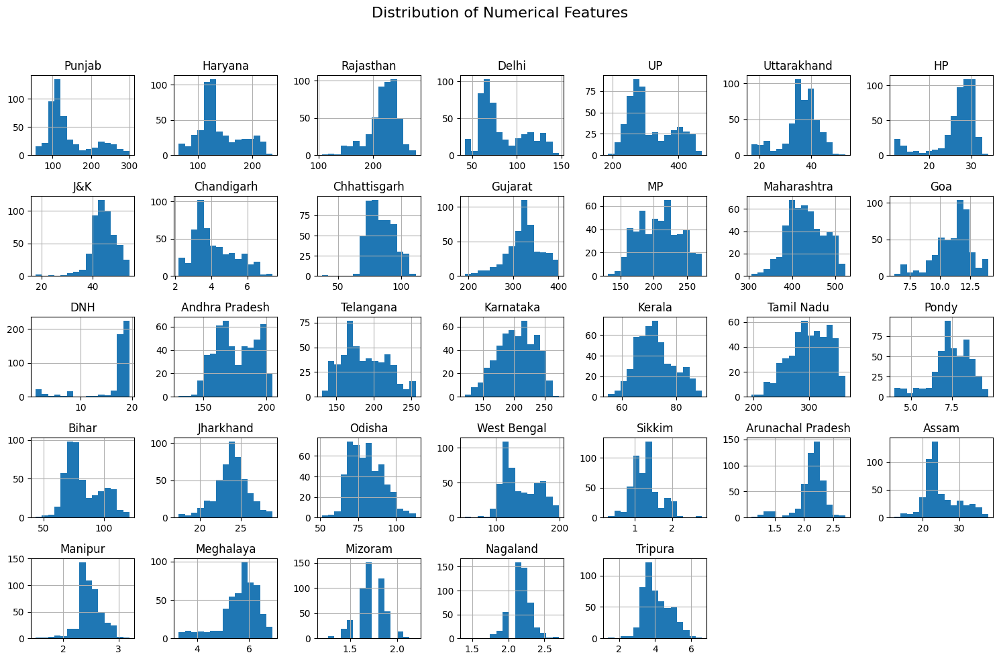

In [8]:
# Step 2: Visualize the distribution of mega units
df[numerical_cols].hist(bins=15, figsize=(15, 10), layout=(5, 7))
plt.suptitle('Distribution of Numerical Features', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [9]:
# Step 3: Visualize relationships between mega units 
sns.pairplot(df[numerical_cols])
plt.suptitle('Pairplot of Numerical Features', y=1.02)
plt.show()

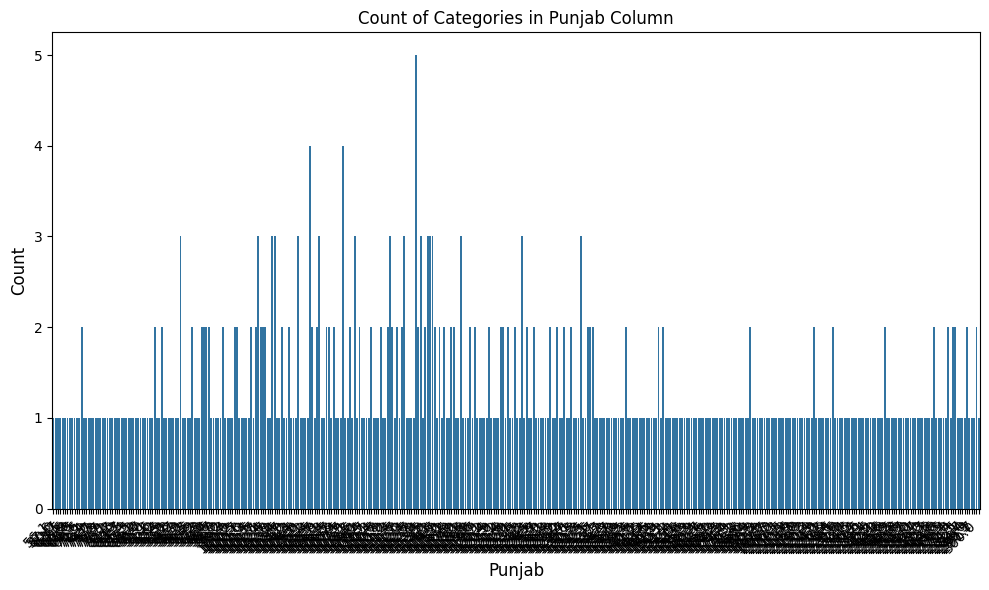

In [14]:
# Step 4: Categorical Feature Analysis(mega units of one state)
if 'Punjab' in df.columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df, x='Punjab')
    plt.title('Count of Categories in Punjab Column')
    
    # Adding x and y axis labels
    plt.xlabel('Punjab', fontsize=12)  # Down label
    plt.ylabel('Count', fontsize=12)  # Side label
    
    plt.xticks(rotation=45, ha='right', fontsize=10)  # Rotate x-axis labels
    plt.tight_layout()  # Ensures the plot fits properly

    plt.show()



Mean Squared Error (MSE): 2438.5160129151473
Mean Absolute Error (MAE): 28.248912371459852
R-squared (R²): 0.42865276927086393


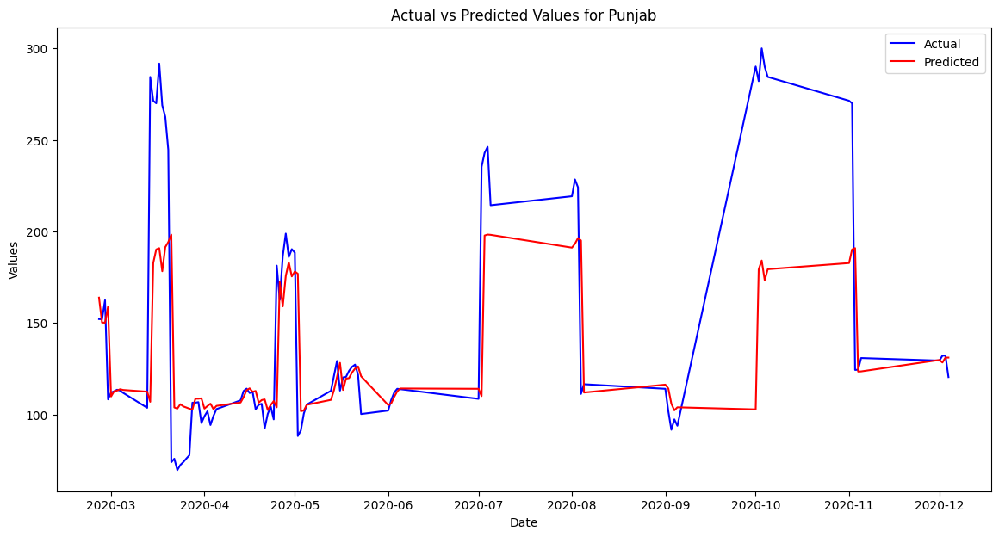

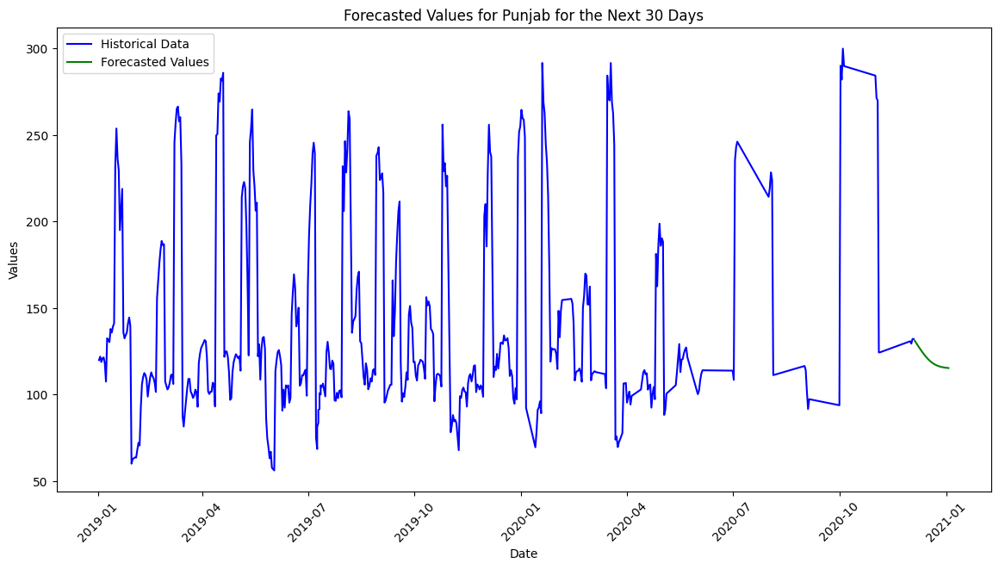

            Forecasted
2020-12-05  131.044732
2020-12-06  129.996916
2020-12-07  128.958709
2020-12-08  127.933211
2020-12-09  126.924389
2020-12-10  125.936959
2020-12-11  124.976210
2020-12-12  124.047778
2020-12-13  123.157368
2020-12-14  122.310447
2020-12-15  121.511937
2020-12-16  120.765929
2020-12-17  120.075459
2020-12-18  119.442357
2020-12-19  118.867195
2020-12-20  118.349325
2020-12-21  117.886999
2020-12-22  117.477551
2020-12-23  117.117609
2020-12-24  116.803325
2020-12-25  116.530579
2020-12-26  116.295172
2020-12-27  116.092973
2020-12-28  115.920032
2020-12-29  115.772664
2020-12-30  115.647488
2020-12-31  115.541455
2021-01-01  115.451850
2021-01-02  115.376280
2021-01-03  115.312656


In [1]:
#Support Vector Machine
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Load the dataset
df = pd.read_csv('C:/Users/Shree/Desktop/dataset_tk.csv')

# Select a state for analysis, e.g., Punjab
state = 'Punjab'
data = df[['Date', state]].copy()

# Convert the 'Date' column to datetime format with dayfirst=True
data['Date'] = pd.to_datetime(data['Date'], dayfirst=True)
data.set_index('Date', inplace=True)

# Prepare the dataset for time series analysis
data[state] = data[state].astype(float)

# Create a new column for the target (next day's value)
data['Target'] = data[state].shift(-1)
data.dropna(inplace=True)

# Split data into features and target
X = data[[state]].values
y = data['Target'].values

# Normalize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, shuffle=False)

# Train the SVM model
svr = SVR(kernel='rbf')
svr.fit(X_train, y_train)

# Make predictions
y_pred = svr.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R-squared (R²): {r2}")

# Plot actual vs predicted values
plt.figure(figsize=(14, 7))
plt.plot(data.index[-len(y_test):], y_test, label='Actual', color='blue')
plt.plot(data.index[-len(y_test):], y_pred, label='Predicted', color='red')
plt.title(f'Actual vs Predicted Values for {state}')
plt.xlabel('Date')
plt.ylabel('Values')
plt.legend()
plt.show()

# Forecast future values (for the next 30 days)
future_predictions = []
last_data_point = X[-1].reshape(1, -1)  # Last known data point

for _ in range(30):
    next_value = svr.predict(scaler.transform(last_data_point))
    future_predictions.append(next_value[0])
    last_data_point = np.array([[next_value[0]]])  # Update last data point

# Generate future dates
last_date = data.index[-1]
future_dates = [last_date + pd.Timedelta(days=i) for i in range(1, 31)]

# Plotting future forecasts
plt.figure(figsize=(14, 7))
plt.plot(data.index, data[state], label='Historical Data', color='blue')
plt.plot(future_dates, future_predictions, label='Forecasted Values', color='green')
plt.title(f'Forecasted Values for {state} for the Next 30 Days')
plt.xlabel('Date')
plt.ylabel('Values')
plt.xticks(rotation=45)
plt.legend()
plt.show()

# Print forecasted values
forecasted_df = pd.DataFrame(data=future_predictions, index=future_dates, columns=['Forecasted'])
print(forecasted_df)


Mean Squared Error (MSE): 846.6527273899991
Mean Absolute Error (MAE): 15.57426999999999
R-squared (R²): 0.8035727564249957


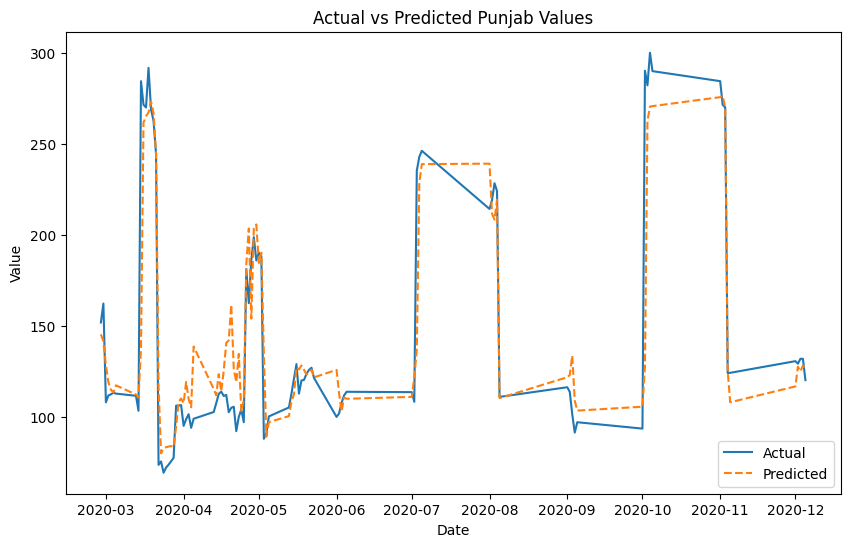

c:\Users\Shree\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
c:\Users\Shree\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
c:\Users\Shree\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
c:\Users\Shree\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
c:\Users\Shree\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid fea

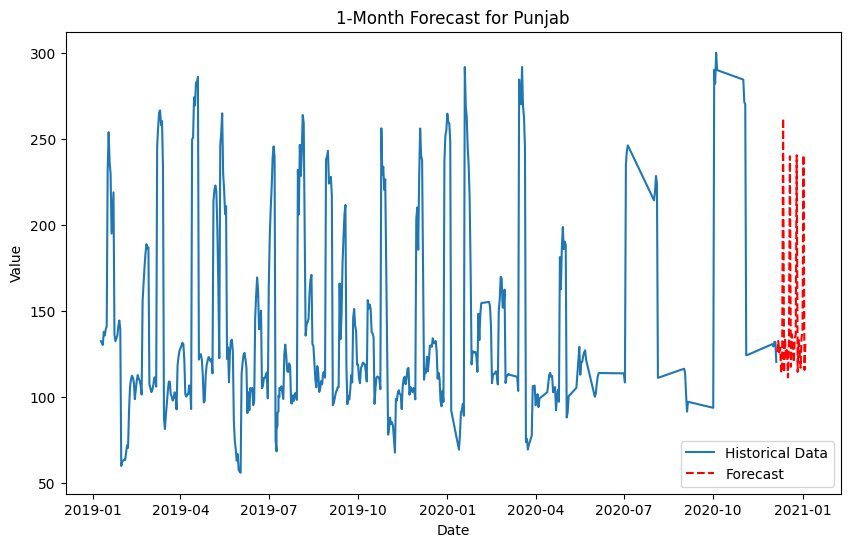

Forecast for the next 30 days:
            Forecast
2020-12-06   126.125
2020-12-07   132.624
2020-12-08   126.036
2020-12-09   128.693
2020-12-10   114.140
2020-12-11   114.914
2020-12-12   261.959
2020-12-13   114.242
2020-12-14   134.069
2020-12-15   122.148
2020-12-16   127.855
2020-12-17   111.441
2020-12-18   131.895
2020-12-19   239.836
2020-12-20   117.597
2020-12-21   136.473
2020-12-22   130.239
2020-12-23   120.298
2020-12-24   134.290
2020-12-25   136.153
2020-12-26   240.442
2020-12-27   114.672
2020-12-28   133.202
2020-12-29   126.834
2020-12-30   117.008
2020-12-31   134.579
2021-01-01   138.429
2021-01-02   240.501
2021-01-03   115.790
2021-01-04   132.264


In [1]:
#Random Forest Regressor 
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Load dataset into pandas dataframe (Using same data for brevity)
df = pd.read_csv('C:/Users/Shree/Desktop/dataset_tk.csv')

# Convert 'Date' to datetime and set as index
df['Date'] = pd.to_datetime(df['Date'], format='%d-%m-%Y')
df.set_index('Date', inplace=True)

# Example using 'Punjab' for forecasting. We can apply it to others in a similar way
df_punjab = df[['Punjab']].copy()  # Use .copy() to avoid SettingWithCopyWarning

# Create lag features (previous days' values) to introduce temporal dependence
for lag in range(1, 8):  # Using the last 7 days as features
    df_punjab.loc[:, f'lag_{lag}'] = df_punjab['Punjab'].shift(lag)

# Drop missing values due to shifting
df_punjab = df_punjab.dropna()  # Assign the result back to df_punjab

# Split into features (X) and target (y)
X = df_punjab.drop('Punjab', axis=1)
y = df_punjab['Punjab']

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Initialize Random Forest Regressor
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Train the model
rf.fit(X_train, y_train)

# Make predictions on the test set
y_pred = rf.predict(X_test)

# Calculate model performance metrics
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error (MSE): {mse}')
print(f'Mean Absolute Error (MAE): {mae}')
print(f'R-squared (R²): {r2}')

# Plot Actual vs Predicted values
plt.figure(figsize=(10, 6))
plt.plot(y_test.index, y_test, label='Actual')
plt.plot(y_test.index, y_pred, label='Predicted', linestyle='--')
plt.title('Actual vs Predicted Punjab Values')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.show()

# Forecast future values for the next 30 days
future_steps = 30
last_known_data = df_punjab.iloc[-1, 1:].values.reshape(1, -1)  # Last known lag features

forecast_dates = pd.date_range(start=df_punjab.index[-1] + pd.Timedelta(days=1), periods=future_steps)
forecast_values = []

for _ in range(future_steps):
    next_pred = rf.predict(last_known_data)
    forecast_values.append(next_pred[0])
    
    # Update lag features for the next prediction
    last_known_data = np.roll(last_known_data, -1)  # Shift lag features
    last_known_data[0, -1] = next_pred[0]  # Add new prediction to the last lag

# Create a DataFrame to hold the forecasted results
forecast_df = pd.DataFrame(forecast_values, index=forecast_dates, columns=['Forecast'])

# Plot forecasted values for the next 30 days
plt.figure(figsize=(10, 6))
plt.plot(df_punjab.index, df_punjab['Punjab'], label='Historical Data')
plt.plot(forecast_df.index, forecast_df['Forecast'], label='Forecast', linestyle='--', color='red')
plt.title('1-Month Forecast for Punjab')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.show()

# Display forecasted values
print(f"Forecast for the next {future_steps} days:")
print(forecast_df)


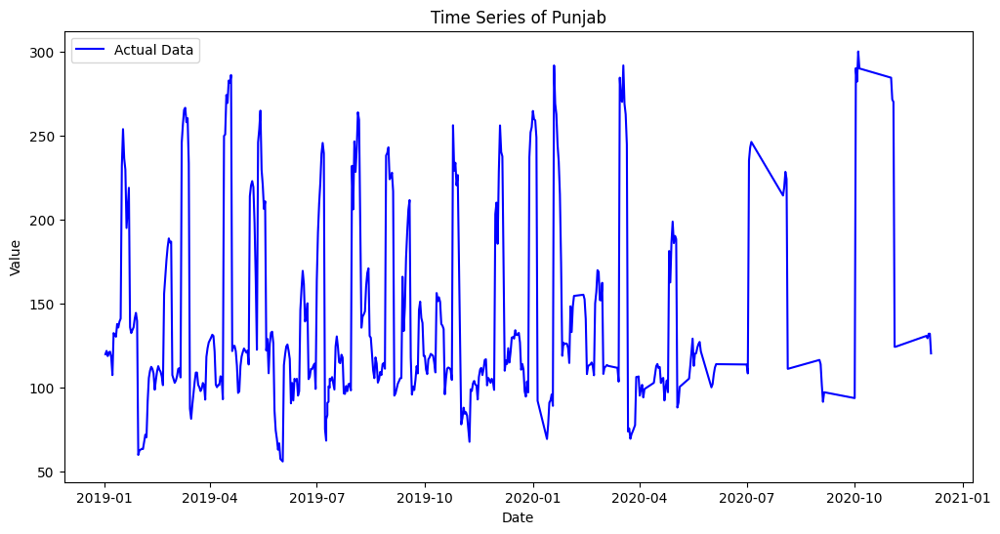

c:\Users\Shree\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Shree\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Shree\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Shree\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary startin

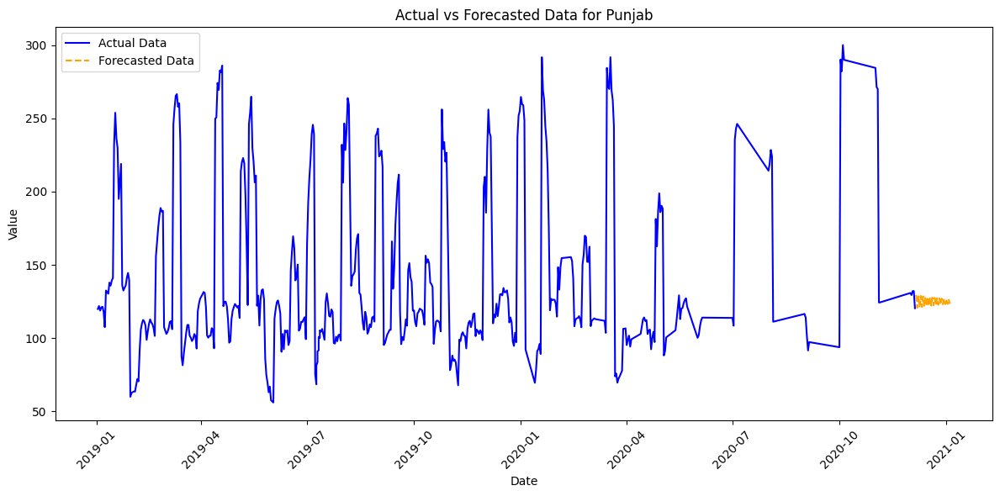

Mean Absolute Error: 17.23
Mean Squared Error: 1297.00
R-squared: 0.60
Forecasted Values for the Next Month:
2020-12-06: 129.41
2020-12-07: 120.72
2020-12-08: 129.11
2020-12-09: 121.01
2020-12-10: 128.82
2020-12-11: 121.28
2020-12-12: 128.56
2020-12-13: 121.54
2020-12-14: 128.31
2020-12-15: 121.78
2020-12-16: 128.08
2020-12-17: 122.00
2020-12-18: 127.87
2020-12-19: 122.20
2020-12-20: 127.67
2020-12-21: 122.40
2020-12-22: 127.48
2020-12-23: 122.58
2020-12-24: 127.31
2020-12-25: 122.74
2020-12-26: 127.15
2020-12-27: 122.90
2020-12-28: 127.00
2020-12-29: 123.04
2020-12-30: 126.86
2020-12-31: 123.17
2021-01-01: 126.73
2021-01-02: 123.30
2021-01-03: 126.61
2021-01-04: 123.42


In [3]:
# Autoregressive Integrated Moving Average (ARIMA) 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Load the dataset
df = pd.read_csv('C:/Users/Shree/Desktop/dataset_tk.csv')

# Preprocess the Data
df['Date'] = pd.to_datetime(df['Date'], format='%d-%m-%Y')
df.set_index('Date', inplace=True)

# Selecting one state for analysis (e.g., Punjab)
series = df['Punjab']

# Step 3: Time Series Analysis
plt.figure(figsize=(12, 6))
plt.plot(series, label='Actual Data', color='blue')
plt.title('Time Series of Punjab')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.show()

# Step 4: Fit ARIMA Model
model = ARIMA(series, order=(1, 1, 1))  # Adjust the order (p, d, q) as needed
model_fit = model.fit()

# Step 5: Forecasting
forecast_steps = 30  # Forecast for the next month
forecast = model_fit.forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=series.index[-1] + pd.Timedelta(days=1), periods=forecast_steps, freq='D')

# Step 6: Visualize
plt.figure(figsize=(12, 6))
plt.plot(series, label='Actual Data', color='blue')
plt.plot(forecast_index, forecast, label='Forecasted Data', color='orange', linestyle='--')
plt.title('Actual vs Forecasted Data for Punjab')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.tight_layout()  # Adjust layout
plt.show()

# Step 7: Calculate Accuracy
# Since we don't have actual future values, we will calculate the metrics using the last available values
# Here we would usually compare with the actual future values.
# For demonstration purposes, we can only calculate the accuracy on the training data if needed.

# Calculate MAE, MSE, and R-squared on the training set
predictions = model_fit.predict(start=series.index[0], end=series.index[-1])
mae = mean_absolute_error(series, predictions)
mse = mean_squared_error(series, predictions)
r2 = r2_score(series, predictions)

# Print accuracy metrics
print(f'Mean Absolute Error: {mae:.2f}')
print(f'Mean Squared Error: {mse:.2f}')
print(f'R-squared: {r2:.2f}')

# Print forecasted values for the next month
print("Forecasted Values for the Next Month:")
for date, value in zip(forecast_index, forecast):
    print(f'{date.date()}: {value:.2f}')


In [8]:
#Model Comparisom
import pandas as pd

# Define the performance metrics for each model
data = {
    'Model': ['Random Forest', 'AIRMA', 'SVM'],
    'Mean Squared Error (MSE)': [846.6527273899991, 1297.00, 2438.5160129151473],
    'Mean Absolute Error (MAE)': [15.57426999999999, 17.23, 28.248912371459852],
    'R-squared (R²)': [0.8035727564249957, 0.60, 0.42865276927086393],
}

# Create a DataFrame
df_models = pd.DataFrame(data)

# Set display options for better alignment
pd.set_option('display.expand_frame_repr', False)  # Prevents wrapping of the DataFrame

# Display the DataFrame
print("Model Comparison:")
print(df_models)

# Sort models by MSE
df_sorted_by_mse = df_models.sort_values(by='Mean Squared Error (MSE)')
print("\nModels sorted by Mean Squared Error (MSE):")
print(df_sorted_by_mse)

# Sort models by MAE
df_sorted_by_mae = df_models.sort_values(by='Mean Absolute Error (MAE)')
print("\nModels sorted by Mean Absolute Error (MAE):")
print(df_sorted_by_mae)

# Sort models by R-squared
df_sorted_by_r2 = df_models.sort_values(by='R-squared (R²)', ascending=False)
print("\nModels sorted by R-squared (R²):")
print(df_sorted_by_r2)


Model Comparison:
           Model  Mean Squared Error (MSE)  Mean Absolute Error (MAE)  R-squared (R²)
0  Random Forest                846.652727                  15.574270        0.803573
1          AIRMA               1297.000000                  17.230000        0.600000
2            SVM               2438.516013                  28.248912        0.428653

Models sorted by Mean Squared Error (MSE):
           Model  Mean Squared Error (MSE)  Mean Absolute Error (MAE)  R-squared (R²)
0  Random Forest                846.652727                  15.574270        0.803573
1          AIRMA               1297.000000                  17.230000        0.600000
2            SVM               2438.516013                  28.248912        0.428653

Models sorted by Mean Absolute Error (MAE):
           Model  Mean Squared Error (MSE)  Mean Absolute Error (MAE)  R-squared (R²)
0  Random Forest                846.652727                  15.574270        0.803573
1          AIRMA               12

In [9]:
import numpy as np
from scipy import stats

# Replace these hypothetical error values with your actual errors
random_forest_errors = np.array([10, -5, 3, 8, -4, 2, 1, -3])  # Errors for Random Forest
airma_errors = np.array([15, -6, 4, 7, -5, 3, 2, -2])           # Errors for AIRMA
svm_errors = np.array([20, -8, 6, 10, -3, 5, 4, -1])            # Errors for SVM

# Perform paired t-tests
t_test_rf_airma = stats.ttest_rel(random_forest_errors, airma_errors)
t_test_rf_svm = stats.ttest_rel(random_forest_errors, svm_errors)

# Print the results
print("Random Forest vs. AIRMA:")
print(f"T-statistic: {t_test_rf_airma.statistic}, P-value: {t_test_rf_airma.pvalue}")

print("\nRandom Forest vs. SVM:")
print(f"T-statistic: {t_test_rf_svm.statistic}, P-value: {t_test_rf_svm.pvalue}")


Random Forest vs. AIRMA:
T-statistic: -1.0702591020190138, P-value: 0.3200118823886309

Random Forest vs. SVM:
T-statistic: -2.072067359729051, P-value: 0.07698144278635677
